# Feature Engineering notebook
Loads the lightweight clean data, and finds the most useful features for per-step awake classification 

## Imports

In [2]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
import seaborn as sns
import plotly.express as px
import gc

## Prepare data

In [3]:
data = pd.read_parquet('../../../data/raw/Zzzs_train.parquet')
data.rename(columns={'awake':'target'}, inplace=True)
data.head()

,series_id,step,timestamp,anglez,enmo,target
0,08db4255286f,0,2018-11-05T10:00:00-0400,-30.845301,0.0447,1
1,08db4255286f,1,2018-11-05T10:00:05-0400,-34.181801,0.0443,1
2,08db4255286f,2,2018-11-05T10:00:10-0400,-33.877102,0.0483,1
3,08db4255286f,3,2018-11-05T10:00:15-0400,-34.282101,0.0680,1
4,08db4255286f,4,2018-11-05T10:00:20-0400,-34.385799,0.0768,1


Determine train test split based on series_id, and add this as a column

In [4]:
sids = data.series_id.unique()
test_size = 0.2
np.random.seed(42)
np.random.shuffle(sids)
data['train'] = data.series_id.isin(sids[:-int(len(sids)*test_size)])

## Helper functions
Define a function that will be used to determine usefulness of a feature, by training a simple classifier on the feature, and returning the auroc score
Also add functions to show the results

In [5]:
def compute_feature_importance(df, feature, res_dict=None, plot=False, subsample=100, plot_limit=17280, plot_subsample=1):
    from sklearn.linear_model import LogisticRegression
    from sklearn.metrics import roc_auc_score
    cols = [feature, 'target','train']
    selection = df[cols][::subsample]
    train = selection[selection.train]
    test = selection[~selection.train]
    
    clf = LogisticRegression()
    clf.fit(train[[feature]], train.target)
    preds = clf.predict_proba(test[[feature]])[:,1]
    score = roc_auc_score(test.target, preds)
    
    if res_dict is not None:
        res_dict[feature] = score
        
    if plot:
        # plot with plotly
        print(f"AUROC: {score:.4f}")
        preds_df = pd.DataFrame({'target':test.target, 'pred':preds})
        preds_df = preds_df[:plot_limit:plot_subsample]
        fig = px.line(preds_df, x=range(len(preds_df)), y=['pred', 'target'])
        fig.show()    
    return score

In [6]:
res = dict()

In [7]:
def show_res(res, with_plotly=False):
    res_df = pd.DataFrame.from_dict(res, orient='index', columns=['auroc'])
    res_df.sort_values('auroc', ascending=False, inplace=True)
    
    if with_plotly:
        # plot with plotly
        fig = px.bar(res_df, x=res_df.index, y='auroc', title='Feature explanation power (logistic regression)')
        fig.show()
        return
    else:
        # plot with seaborn
        ax = sns.barplot(x=res_df.index, y=res_df.auroc, palette="deep")
        ax.bar_label(ax.containers[0], fmt='%.4f', label_type='edge')
        plt.xticks(rotation=45)
        plt.show()

# Let's start

Compute the importance of the standard features

  0%|          | 0/2 [00:00<?, ?it/s]

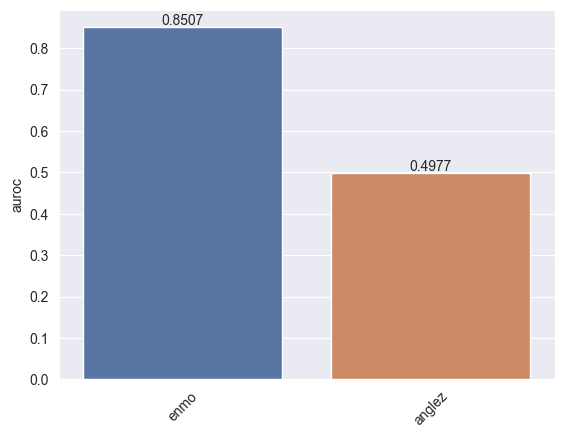

In [8]:
feats = ['anglez', 'enmo']
for feat in tqdm(feats):
    compute_feature_importance(data, feat, res)
show_res(res)

Add some features to make anglez more usable

Computing features


Computing feature importance:   0%|          | 0/3 [00:00<?, ?it/s]

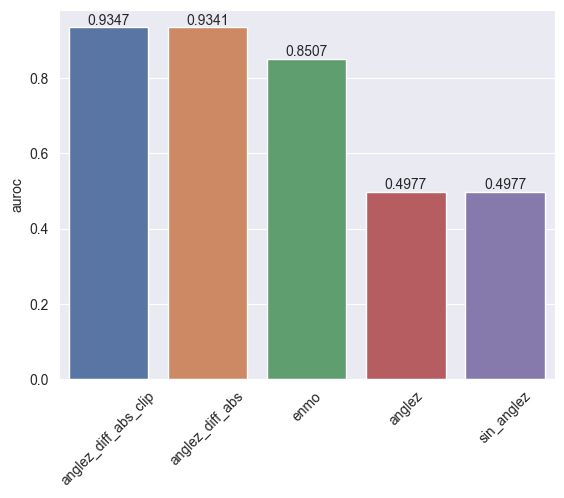

In [9]:
print('Computing features')
data['anglez_diff_abs'] = np.abs(data.anglez.diff()).fillna(0).astype(np.float32)
data['anglez_diff_abs_clip'] = np.clip(data.anglez_diff_abs, 0, 10).astype(np.float32)
data['sin_anglez'] = np.sin(data.anglez/180*np.pi).astype(np.float32)
feats = ['anglez_diff_abs', 'sin_anglez', 'anglez_diff_abs_clip']
for feat in tqdm(feats, desc='Computing feature importance'):
    if feat in res:
        continue
    compute_feature_importance(data, feat, res)
show_res(res)

Lets add the hour features, but instead of the value, use the proportion for which children are awake at that hour in the train set

Extracting hour from timestamp
Mapping hour to proportion of awake


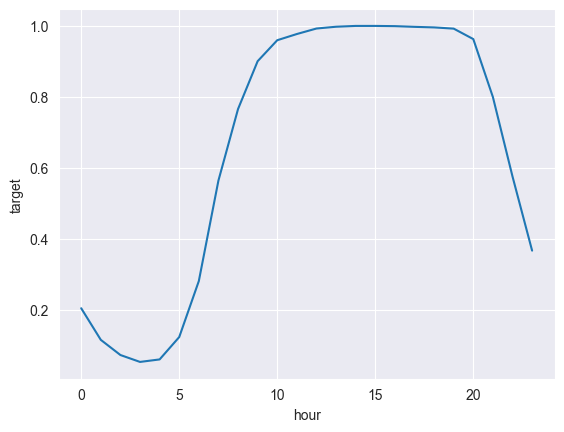

Smoothing the feature with a rolling mean
Computing feature importance


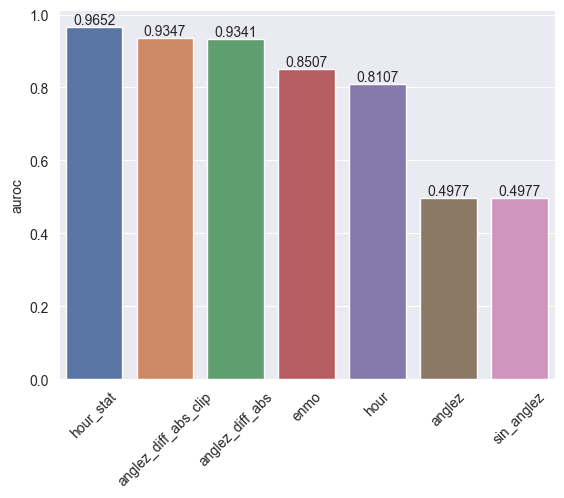

In [10]:
# since converting to timestamp is super slow, do it with substring, 
# using that the date format is like 2018-11-05T10:00:00-0400
print("Extracting hour from timestamp")
data['hour'] = data.timestamp.str[11:13].astype(int)

print("Mapping hour to proportion of awake")
hour_stats = data[data.train].groupby('hour').target.mean()
sns.lineplot(data=hour_stats)
plt.show()
data['hour_stat'] = data.hour.map(hour_stats)

print("Smoothing the feature with a rolling mean")
sec_per_step= 5
data['hour_stat'] = data.hour_stat.rolling(60*60//sec_per_step, center=True).mean().ffill().bfill().astype(np.float32)

print("Computing feature importance")
compute_feature_importance(data, 'hour', res)
compute_feature_importance(data, 'hour_stat', res)

show_res(res)

Also add the minute feature directly

Extracting minute from timestamp


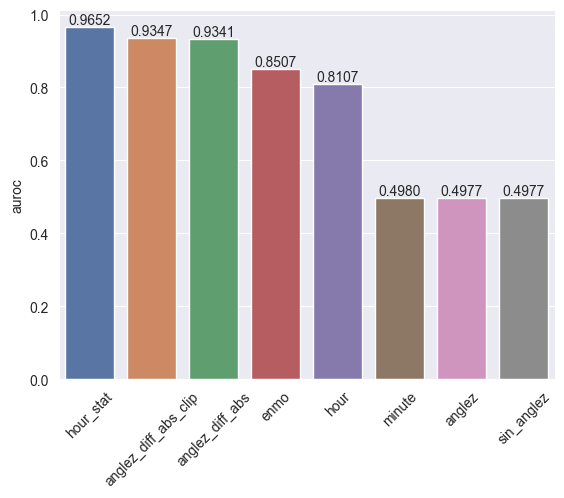

In [11]:
print("Extracting minute from timestamp")
data['minute'] = data.timestamp.str[14:16].astype(int)
compute_feature_importance(data, 'minute', res)
show_res(res)

These will form our basic features.
We distinguish which ones to compute a rolling window for.

In [12]:
basic_feats = ['enmo', 'anglez_diff_abs', 'anglez_diff_abs_clip', 'sin_anglez', 'hour', 'hour_stat']
basic_feats_for_rolling = ['enmo', 'anglez_diff_abs', 'anglez_diff_abs_clip', 'sin_anglez']

# Now let's add some rolling statistics

In [13]:
print("Computing rolling statistics")
stats = ['mean', 'std', 'min', 'max', 'median', 'skew','kurt']
window_sizes = [6, 12, 36, 50, 90, 180, 360, 500, 1000]
pbar = tqdm(total=len(stats)*len(basic_feats_for_rolling)*len(window_sizes))
new_feats = dict()
for stat in stats:
    for feat in basic_feats_for_rolling:
        for window_size in window_sizes:
            name = f'{feat}_{stat}_{window_size}'
            pbar.set_description(f'Computing {name}')
            if name not in data.columns:
                new_feats[name] = data[feat].rolling(window_size, center=True).agg(stat).ffill().bfill().astype(np.float32)
            pbar.update()
pbar.close()

# concatenate the new features with the original data
print("Concatenating new features")
new_feats_df = pd.DataFrame(new_feats)
data = pd.concat([data, new_feats_df], axis=1)

Computing rolling statistics


  0%|          | 0/252 [00:00<?, ?it/s]

Concatenating new features


Save the data for later use

In [14]:
if 'data' in locals():
    data.to_parquet('../../../data/processed/Zzzs_train_features.parquet')
else:
    data = pd.read_parquet('../../../data/processed/Zzzs_train_features.parquet')

In [15]:
rolling_feats = [f for f in data.columns if any([stat in f for stat in stats])]
pbar = tqdm(rolling_feats)
for feat in pbar:
    pbar.set_description(f'Computing explaining power of {feat}')
    if feat in res:
        continue
    compute_feature_importance(data, feat, res) 
pbar.close()

  0%|          | 0/253 [00:00<?, ?it/s]

C:\Users\EmielW\Epoch\Competitions\cmi\q1-detect-sleep-states\venv\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [16]:
show_res(res, with_plotly=True)

Compute the correlation between the features (with a subset of the data for performance reasons)
We can use this to select features that are not too correlated.

In [17]:
def select_useful_uncorrelated(data, res, subsample=1000):
    data_corr = data[::subsample].corr(numeric_only=True)
    
    # select features by sorting the res descending, and removing features that are too correlated to the ones that came before
    selection = []
    res_df = pd.DataFrame.from_dict(res, orient='index', columns=['auroc'])
    res_df.sort_values('auroc', ascending=False, inplace=True)
    
    for feat in res_df.index:
        if len(selection) == 0:
            selection.append(feat)
            continue
        if data_corr.loc[feat, selection].abs().max() < 0.9:
            selection.append(feat)
    
    print(f"Selected {len(selection)} features out of {len(res)}")
    print(selection)
    return data_corr, selection
    

In [18]:
data_corr, selection_long = select_useful_uncorrelated(data, res, subsample=1000)

Selected 142 features out of 260
['anglez_diff_abs_clip_skew_1000', 'anglez_diff_abs_clip_mean_1000', 'anglez_diff_abs_clip_kurt_1000', 'anglez_diff_abs_clip_skew_500', 'anglez_diff_abs_kurt_1000', 'anglez_diff_abs_clip_kurt_500', 'anglez_diff_abs_clip_skew_360', 'anglez_diff_abs_clip_median_360', 'enmo_mean_1000', 'enmo_std_500', 'anglez_diff_abs_median_90', 'anglez_diff_abs_kurt_500', 'anglez_diff_abs_clip_std_360', 'anglez_diff_abs_clip_mean_36', 'enmo_mean_360', 'enmo_max_1000', 'hour_stat', 'anglez_diff_abs_clip_median_12', 'enmo_std_180', 'anglez_diff_abs_clip_skew_180', 'enmo_max_360', 'anglez_diff_abs_clip_std_90', 'anglez_diff_abs_std_1000', 'anglez_diff_abs_median_6', 'anglez_diff_abs_clip_min_12', 'anglez_diff_abs_min_6', 'enmo_std_50', 'anglez_diff_abs_mean_12', 'anglez_diff_abs_clip_min_36', 'anglez_diff_abs_kurt_360', 'enmo_mean_90', 'enmo_max_90', 'anglez_diff_abs_std_360', 'enmo_std_12', 'anglez_diff_abs_clip_min_50', 'enmo_std_6', 'anglez_diff_abs_clip', 'sin_anglez_st

## Plotting
Plot the result of a predictor trained on all features

In [51]:
def train_model(data, feats, plot_preds=False, target='target', plot_days=5, plot_subsample=1):
    from catboost import CatBoostClassifier
    from sklearn.metrics import roc_auc_score
    train = data[data.train]
    test = data[~data.train]
    clf = CatBoostClassifier(eval_metric='AUC')
    clf.fit(train[feats], train[target], eval_set=(test[feats], test[target]), early_stopping_rounds=5)
    preds = clf.predict_proba(test[feats])[:,1]
    auroc = roc_auc_score(test[target], preds)
    print(f"AUROC: {auroc:.4f}")
    
    if plot_preds:
        # plot with plotly detailed
        df = pd.DataFrame({'preds': preds, 'target': test[target]})
        df_display = df[:plot_days*17280:plot_subsample]
        fig = px.line(df_display, x=range(len(df_display)), y=['preds', 'target'])
        fig.show()
    
    return clf, auroc

In [20]:
clf_long, _ = train_model(data, basic_feats + rolling_feats, plot_preds=True)

Learning rate set to 0.309538
0:	test: 0.9943978	best: 0.9943978 (0)	total: 1.51s	remaining: 25m 9s
1:	test: 0.9952242	best: 0.9952242 (1)	total: 2.61s	remaining: 21m 41s
2:	test: 0.9958153	best: 0.9958153 (2)	total: 3.72s	remaining: 20m 37s
3:	test: 0.9962663	best: 0.9962663 (3)	total: 4.81s	remaining: 19m 58s
4:	test: 0.9962888	best: 0.9962888 (4)	total: 5.81s	remaining: 19m 16s
5:	test: 0.9963985	best: 0.9963985 (5)	total: 6.78s	remaining: 18m 43s
6:	test: 0.9963063	best: 0.9963985 (5)	total: 7.68s	remaining: 18m 9s
7:	test: 0.9963360	best: 0.9963985 (5)	total: 8.89s	remaining: 18m 23s
8:	test: 0.9963222	best: 0.9963985 (5)	total: 9.92s	remaining: 18m 12s
9:	test: 0.9963999	best: 0.9963999 (9)	total: 11s	remaining: 18m 6s
10:	test: 0.9963403	best: 0.9963999 (9)	total: 11.9s	remaining: 17m 47s
11:	test: 0.9964129	best: 0.9964129 (11)	total: 12.9s	remaining: 17m 45s
12:	test: 0.9964912	best: 0.9964912 (12)	total: 14.6s	remaining: 18m 26s
13:	test: 0.9964021	best: 0.9964912 (12)	total:

In [21]:
def get_importances(clf, feats, plot=True):
    importances = clf.get_feature_importance()
    importances_df = pd.DataFrame({'feature':feats, 'importance':importances})
    importances_df.importance /= importances_df.importance.sum()
    importances_df.sort_values('importance', ascending=False, inplace=True)
    if plot:
        fig = px.bar(importances_df, x='feature', y='importance')
        fig.show()
    return importances_df

In [22]:
importances_long = get_importances(clf_long, basic_feats + rolling_feats)

# Precise dataset
So far we have measured AUROC across the entire day. Preferring features that are good for a high-level overview.
Now we will try to predict awake for only the short windows around transitions of the target.

In [23]:
# first compute the transitions
window_size = 180
data['transition'] = (data.target != data.target.shift(1)).astype(int)
data['window'] = data.transition.rolling(window_size, center=True).sum().ffill().bfill()

In [24]:
# plot the first few windows
data_start = data[:50000:18][['step', 'target', 'window']]
px.scatter(data_start, x='step', y='target', color='window')

Ran into some memory issues here when filtering the dataset, so lets print the memory usage for debugging purposes

In [25]:
import gc
mem = data.memory_usage().sum()/(1024**3)
print(f"Dataframe size before selection: {mem:.2f} GB")
gc.collect()

Dataframe size before selection: 13.25 GB


11

In [26]:
# make a new dataset with only the windows
data_windows = data[data.window>0].copy()
mem = data_windows.memory_usage().sum()/(1024**3)
print(f"Datafram after selection: {mem:.2f} GB")
gc.collect()

Datafram after selection: 0.28 GB


0

# Precise datset feature importance

In [27]:
res_windows = dict()
feats = basic_feats + rolling_feats
pbar = tqdm(feats)
for feat in pbar:
    pbar.set_description(f'Computing explaining power of {feat}')
    if feat in res_windows:
        continue
    compute_feature_importance(data_windows, feat, res_windows)

  0%|          | 0/259 [00:00<?, ?it/s]

In [28]:
show_res(res_windows, with_plotly=True)

In [29]:
# select features by sorting the res descending, and removing features that are too correlated to the ones that came before
data_corr_short, selection_short = select_useful_uncorrelated(data_windows, res_windows, subsample=10)

Selected 158 features out of 259
['anglez_diff_abs_mean_90', 'anglez_diff_abs_clip_std_90', 'anglez_diff_abs_std_90', 'anglez_diff_abs_std_50', 'anglez_diff_abs_clip_std_50', 'anglez_diff_abs_clip_mean_36', 'anglez_diff_abs_clip_mean_180', 'enmo_std_50', 'anglez_diff_abs_clip_skew_180', 'enmo_std_90', 'anglez_diff_abs_clip_std_180', 'sin_anglez_std_50', 'anglez_diff_abs_clip_skew_90', 'anglez_diff_abs_clip_median_90', 'anglez_diff_abs_clip_kurt_90', 'anglez_diff_abs_clip_median_180', 'anglez_diff_abs_clip_median_360', 'sin_anglez_std_90', 'enmo_mean_90', 'anglez_diff_abs_median_36', 'anglez_diff_abs_std_180', 'anglez_diff_abs_mean_12', 'anglez_diff_abs_clip_max_36', 'anglez_diff_abs_clip_max_50', 'anglez_diff_abs_max_12', 'anglez_diff_abs_clip_mean_360', 'anglez_diff_abs_clip_max_12', 'anglez_diff_abs_kurt_180', 'enmo_std_12', 'anglez_diff_abs_clip_skew_360', 'anglez_diff_abs_clip_kurt_360', 'anglez_diff_abs_clip_mean_6', 'anglez_diff_abs_clip_max_6', 'anglez_diff_abs_median_12', 'angl

# Lets visualize the predictions of a model trained on the precise dataset

In [30]:
clf_short, auroc = train_model(data_windows, feats, plot_preds=True, plot_days=1, plot_subsample=1)

Learning rate set to 0.118809
0:	test: 0.9005692	best: 0.9005692 (0)	total: 45.7ms	remaining: 45.7s
1:	test: 0.9090148	best: 0.9090148 (1)	total: 86ms	remaining: 42.9s
2:	test: 0.9109900	best: 0.9109900 (2)	total: 124ms	remaining: 41.1s
3:	test: 0.9114380	best: 0.9114380 (3)	total: 158ms	remaining: 39.4s
4:	test: 0.9132078	best: 0.9132078 (4)	total: 194ms	remaining: 38.5s
5:	test: 0.9143720	best: 0.9143720 (5)	total: 231ms	remaining: 38.3s
6:	test: 0.9174891	best: 0.9174891 (6)	total: 265ms	remaining: 37.5s
7:	test: 0.9168125	best: 0.9174891 (6)	total: 301ms	remaining: 37.3s
8:	test: 0.9172845	best: 0.9174891 (6)	total: 334ms	remaining: 36.8s
9:	test: 0.9175738	best: 0.9175738 (9)	total: 367ms	remaining: 36.3s
10:	test: 0.9178650	best: 0.9178650 (10)	total: 398ms	remaining: 35.8s
11:	test: 0.9182490	best: 0.9182490 (11)	total: 430ms	remaining: 35.4s
12:	test: 0.9189270	best: 0.9189270 (12)	total: 461ms	remaining: 35s
13:	test: 0.9203014	best: 0.9203014 (13)	total: 495ms	remaining: 34.9

In [31]:
importances_short = get_importances(clf_short, feats)

In [32]:
# Repeat with selection
clf_short_selection, auroc = train_model(data_windows, selection_short, plot_preds=True, plot_days=1, plot_subsample=1)

Learning rate set to 0.118809
0:	test: 0.9012579	best: 0.9012579 (0)	total: 31.2ms	remaining: 31.2s
1:	test: 0.9066966	best: 0.9066966 (1)	total: 59.1ms	remaining: 29.5s
2:	test: 0.9109909	best: 0.9109909 (2)	total: 87.8ms	remaining: 29.2s
3:	test: 0.9109275	best: 0.9109909 (2)	total: 115ms	remaining: 28.7s
4:	test: 0.9124047	best: 0.9124047 (4)	total: 142ms	remaining: 28.3s
5:	test: 0.9139139	best: 0.9139139 (5)	total: 171ms	remaining: 28.3s
6:	test: 0.9150547	best: 0.9150547 (6)	total: 197ms	remaining: 28s
7:	test: 0.9161753	best: 0.9161753 (7)	total: 223ms	remaining: 27.7s
8:	test: 0.9164480	best: 0.9164480 (8)	total: 250ms	remaining: 27.5s
9:	test: 0.9169764	best: 0.9169764 (9)	total: 275ms	remaining: 27.2s
10:	test: 0.9178264	best: 0.9178264 (10)	total: 300ms	remaining: 27s
11:	test: 0.9185667	best: 0.9185667 (11)	total: 328ms	remaining: 27s
12:	test: 0.9193241	best: 0.9193241 (12)	total: 356ms	remaining: 27s
13:	test: 0.9196338	best: 0.9196338 (13)	total: 381ms	remaining: 26.8s
1

# Event features
These features work well for state segmentation. Now let's see which features work well for events. And add a few features that make more sense for events.
Starting by getting the moments (i.e. slope etc.) of the most important state segmentation features, for both long-term and precise.
Also add onset_stat and wakeup_stat.

In [36]:
# take the most important features from both long and short-term feature importance
threshold = 0.01
feats_long = importances_long[importances_long.importance>threshold].feature.tolist()
feats_short = importances_short[importances_short.importance>threshold].feature.tolist()
feats_good = list(set(feats_long + feats_short))

# combine them in a dataframe with importances
feats_df = pd.DataFrame({'feature':feats_good})
feats_df['importance_long'] = feats_df.feature.map(importances_long.set_index('feature').importance)
feats_df['importance_short'] = feats_df.feature.map(importances_short.set_index('feature').importance)

print(f"Selected {len(feats_good)} features")
print(feats_good)
feats_df

Selected 50 features
['anglez_diff_abs_clip_max_12', 'anglez_diff_abs_skew_1000', 'anglez_diff_abs_clip_std_1000', 'enmo_max_360', 'anglez_diff_abs_clip_mean_90', 'enmo_std_1000', 'sin_anglez_median_180', 'enmo_median_36', 'sin_anglez_std_36', 'anglez_diff_abs_clip_mean_180', 'enmo_mean_1000', 'enmo_std_12', 'anglez_diff_abs_clip_std_36', 'sin_anglez_min_1000', 'anglez_diff_abs_median_180', 'anglez_diff_abs_max_500', 'anglez_diff_abs_clip_std_90', 'sin_anglez_max_1000', 'enmo_median_1000', 'hour_stat', 'anglez_diff_abs_median_1000', 'anglez_diff_abs_clip_skew_1000', 'anglez_diff_abs_clip_mean_500', 'enmo_median_180', 'enmo_max_500', 'anglez_diff_abs_clip_max_50', 'sin_anglez_skew_500', 'enmo_std_50', 'anglez_diff_abs_clip_median_360', 'enmo_std_90', 'anglez_diff_abs_median_500', 'enmo_max_180', 'enmo_max_1000', 'anglez_diff_abs_max_50', 'anglez_diff_abs_kurt_1000', 'anglez_diff_abs_clip_median_90', 'sin_anglez_median_360', 'anglez_diff_abs_clip_median_1000', 'anglez_diff_abs_clip_kurt_

,feature,importance_long,importance_short
0,anglez_diff_abs_clip_max_12,0.000000,0.011734
1,anglez_diff_abs_skew_1000,0.000000,0.012904
2,anglez_diff_abs_clip_std_1000,0.030612,0.000000
3,enmo_max_360,0.000000,0.010028
4,anglez_diff_abs_clip_mean_90,0.000000,0.064746
5,enmo_std_1000,0.016453,0.004623
6,sin_anglez_median_180,0.000000,0.019684
7,enmo_median_36,0.000000,0.016135
8,sin_anglez_std_36,0.010533,0.011376
9,anglez_diff_abs_clip_mean_180,0.000000,0.012441


Compute moments

In [46]:
# compute slope (diff)
print("Computing slope")
feats_moments = list()
for feat in tqdm(feats_good):
    name = f'{feat}_diff'
    if name not in data.columns:
        data[name] = data[feat].diff().fillna(0).astype(np.float32)
    if name not in feats_moments:
        feats_moments.append(name)

Computing slope


  0%|          | 0/50 [00:00<?, ?it/s]

In [82]:
# Create event labels, which are the diff of awake
print("Computing event labels")
data['event_wakeup'] = data.target.diff().fillna(0).astype(int).clip(0,1)

# smooth the event labels with a gaussian
print("Smoothing event labels")
data['event_wakeup'].rolling(11, center=True).sum().ffill().bfill()

# train a model on events 
print("Training event model")
feats = feats_good + feats_moments
gc.collect()
clf_event, auroc = train_model(data, feats, target='event_wakeup', plot_preds=True, plot_days=5, plot_subsample=1)

Computing event labels
Smoothing event labels
Training event model
Learning rate set to 0.309538
0:	test: 0.7337455	best: 0.7337455 (0)	total: 632ms	remaining: 10m 31s
1:	test: 0.7595702	best: 0.7595702 (1)	total: 1.24s	remaining: 10m 20s
2:	test: 0.7622824	best: 0.7622824 (2)	total: 1.83s	remaining: 10m 9s
3:	test: 0.7927256	best: 0.7927256 (3)	total: 2.48s	remaining: 10m 16s
4:	test: 0.9343284	best: 0.9343284 (4)	total: 3.07s	remaining: 10m 11s
5:	test: 0.9779801	best: 0.9779801 (5)	total: 3.65s	remaining: 10m 3s
6:	test: 0.9840399	best: 0.9840399 (6)	total: 4.22s	remaining: 9m 58s
7:	test: 0.9850520	best: 0.9850520 (7)	total: 4.74s	remaining: 9m 47s
8:	test: 0.9871340	best: 0.9871340 (8)	total: 5.33s	remaining: 9m 47s
9:	test: 0.9896867	best: 0.9896867 (9)	total: 5.92s	remaining: 9m 45s
10:	test: 0.9897870	best: 0.9897870 (10)	total: 6.49s	remaining: 9m 43s
11:	test: 0.9897139	best: 0.9897870 (10)	total: 7.07s	remaining: 9m 42s
12:	test: 0.9898982	best: 0.9898982 (12)	total: 7.61s	r

In [85]:
# show importances
importances_event = get_importances(clf_event, feats)

# Get a performance estimate

Computing error


  0%|          | 0/172 [00:00<?, ?it/s]

Plotting error


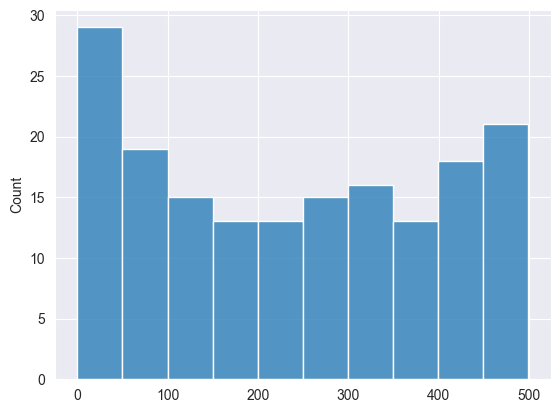

In [86]:
test = data[~data.train]
preds = clf_event.predict_proba(test[feats])[:,1]
target = test.event_wakeup

# iterate over all wakeups, get the argmax of the preds within 500 steps, and compute the distance
# this is a bit slow, but it's only for evaluation
print("Computing error")
errors = []
for onset in tqdm(test[test.event_wakeup==1].step):
    preds_window = preds[onset-500:onset+500]
    pred = preds_window.argmax()
    error = np.abs(pred-500)
    errors.append(error)
    
    sns.lineplot(x=np.arange(-500,500,1), y=preds_window)
    plt.axvline(x=0, color='red')
    plt.savefig(f'./plots/pred_{onset}')
    plt.close()
    
# show a histogram of the errors
print("Plotting error")
sns.histplot(errors, bins=10)
plt.show()